Please use "pip install -r requirements.txt" in your terminal to install the following packages first:<br>
pandas os csv ast numpy textblob seaborn matplotlib wordcloud scipy geopy re fractions requests geopandas folium sklearn selenium time zipfile urllib getpass bs4

# What makes a good public high school in NYC area?

## 0 Problem and Motivation
This project is guided by the big question: What makes a good public high school in NYC area?


### 0-1 WHY PUBLIC HIGH SCHOOL SO IMPORTANT?
Have you ever thought about dropping out from high school? Have you ever worried about your scores in high shcool? No matter what your answer is, graduation from high school is a bare minimum for students’ later academic and socioeconomic success. Also, prior researches indicated that high school grades are a stronger incremental predictor of college outcomes—including what is arguably the most important outcome of all: graduation. (Galla, Brian M., et al., 2019)
However, in the United States, Low academic performance in high school and increasing drop-out rates become major educational issues. it is estimated that Nearly one-third of all public high school students in the U.S. fail to graduate in four years (Chapman et al., 2011; Stillwell and Sable, 2013).

<img style="float: middle;" src="dropoutpoliticalcartoon.png" width="50%">

###  0-2 OUR QUESTIONS
- What do parents/students usually focus on when they write reviews about high schools? 
- How are  public high schools in New York distributed based on different factors?  
- What factors might influence the average graduation rate of public high schools in NY?

Does the project clearly describe the relevant data and its collection?
Does the project clearly explain how the data can be used to draw conclusions about the underlying system?
Does the report clearly explain the work that was done?
Is the project innovative or novel?
Does the project use techniques presented in the course (or clearly related to topics covered in the course) to understand and analyze the data for this problem?
Does the report explain how this work fits around related work in this subject area?
Does the report provide directions for further investigation?

## 1- Relevant data and Collection

We are colleting and processing the data from [Niche](https://www.niche.com/k12/search/best-public-high-schools/m/new-york-city-metro-area/) 

When doing the data collection, we didn't find any official API from the website. So we use [Selenium](https://selenium-python.readthedocs.io/installation.html#introduction) to access to the website, locate elements in a page, and then collect relative variables. There are three steps to collect our data.

Step 1: Collect all the schools we need with their name and the url of detailed information. Below are the columns.

- `name` – the school name
- `url` – the url of its detailed information

Step 2: Collect relative feeatures from the school page in the school list. 

- `Average Graduation Rate` —— The percentage of 12th graders who gradu 
- `Percent Proficient - Math` – The percentage of students that scored at or above proficiency levels on their state math assessment test 
- `Percent Proficient - Reading` – This is the percentage of students that scored at or above proficiency levels on their state reading/language arts assessment test. 
- `Median Household Income` – The median combined gross income of all members of a household who are 15 years or older in the neighborhood.
- `Median Rent` – The median rent in the neighborhood.
- `Median Home Value` – The median amount for which a house would likely sell in the neighborhood.
- `Student Number` – The student number in the school.
- `Free or Reduced Lunch` – The percentage of free or reduced lunch in lunch fee.
- `Safe` – The percentage of students who feel safe in the school survey.
- `Happy` – The percentage of students who feel happy in the school survey.
- `Student Teacher Ratio` – The student teacher ratio in the school.

Step 3: Collect 60 latest reviews of each school in the school list.

- `School` – The school name.
- `Reviews` – The latest review list of that school.
- `Rate` – The star of the specific review.

**Note**: To improve on the readability of the Notebook, we have added the code for our scrappers in the Appendix at the end of this notebook.

## 2- Review Analysis

First, let's analyze the reviews and try to answer our first question: what do parents/students usually focus on when they write reviews about high schools?

In [1]:
import pandas as pd
import os
import csv
import ast
import numpy as np
from textblob import TextBlob
import seaborn as sns
import matplotlib.pyplot as plt
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from scipy.stats.stats import pearsonr   

First we read in data from several `.csv` file we scraped from the website. It contains the review text data and their respective rating stars, but it's still in a very primitive and unprocessed format. So we did some cleaning and preprocessing later.

In [2]:
def read_allcsv(fname_list):
    df = pd.DataFrame()
    for fname in fname_list:
        with open('review/review/{}'.format(fname), newline='', encoding="utf8") as f:
            df_i = pd.read_csv(f)
        df = df.append(df_i)
    return df

all_f = os.listdir("review/review")
df = read_allcsv(all_f)

In [3]:
df

,Unnamed: 0,0,1,2,3,4,5,6,7
0,Long Island City High School,['I dont like this school as much as i thought...,"['review__stars__icon', 'review__stars__icon--...",['I dont like this school as much as i thought...,"['review__stars__icon', 'review__stars__icon--...",['I like how the teachers create the classroom...,"['review__stars__icon', 'review__stars__icon--...",['I like how the teachers create the classroom...,"['review__stars__icon', 'review__stars__icon--..."
1,Liberty High School Academy for Newcomers,"[""I remember the first time I stepped in Liber...","['review__stars__icon', 'review__stars__icon--...",NaN,NaN,NaN,NaN,NaN,NaN
2,Eximius College Preparatory Academy,"['Eximius was a school I wont forget, Best fou...","['review__stars__icon', 'review__stars__icon--...","['Eximius was a school I wont forget, Best fou...","['review__stars__icon', 'review__stars__icon--...","['Eximius was a school I wont forget, Best fou...","['review__stars__icon', 'review__stars__icon--...","[""I'm involved in student council and we are n...","['review__stars__icon', 'review__stars__icon--..."
3,Innovation Diploma Plus,"['Great school, great experience. Thank you ID...","['review__stars__icon', 'review__stars__icon--...",NaN,NaN,NaN,NaN,NaN,NaN
4,Urban Assembly Academy of Government & Law,"[""The is an average school. Most of the studen...","['review__stars__icon', 'review__stars__icon--...","[""The is an average school. Most of the studen...","['review__stars__icon', 'review__stars__icon--...",['My high school was above average when it cam...,"['review__stars__icon', 'review__stars__icon--...",NaN,NaN
5,High School for Law & Public Service,['My overall expo at this school is pretty ave...,"['review__stars__icon', 'review__stars__icon--...",['My overall expo at this school is pretty ave...,"['review__stars__icon', 'review__stars__icon--...",['The food is average school lunch but there a...,"['review__stars__icon', 'review__stars__icon--...",['The food is average school lunch but there a...,"['review__stars__icon', 'review__stars__icon--..."
6,Middlesex County Vocational School - East Brun...,"[""My experience is decent. I'd like to see an ...","['review__stars__icon', 'review__stars__icon--...",NaN,NaN,NaN,NaN,NaN,NaN
7,Urban Assembly School of Design & Construction,"[""I love the staff members. There was this one...","['review__stars__icon', 'review__stars__icon--...","[""I love the staff members. There was this one...","['review__stars__icon', 'review__stars__icon--...","['They could do much better, and it makes me s...","['review__stars__icon', 'review__stars__icon--...","['They could do much better, and it makes me s...","['review__stars__icon', 'review__stars__icon--..."
8,Plainfield Academy for the Arts & Advanced Stu...,['I liked how everything was so simple. You kn...,"['review__stars__icon', 'review__stars__icon--...",['I liked how everything was so simple. You kn...,"['review__stars__icon', 'review__stars__icon--...","[""PAAAS is an okay school. I met a lot of good...","['review__stars__icon', 'review__stars__icon--...","[""PAAAS is an okay school. I met a lot of good...","['review__stars__icon', 'review__stars__icon--..."
9,Essex Street Academy,"[""Very small school, doesn't prepare students ...","['review__stars__icon', 'review__stars__icon--...",NaN,NaN,NaN,NaN,NaN,NaN


As you can see, the dataframe has a column of school names. At the same row are the lists of review texts and their respective star ratings. However, each rating is encoded as a set of`'review__stars__icon', 'review__stars__icon--40', 'review__stars__number__reviews'` for an instance to indicate a 4-star review. So we need to extract that infromation from the text. As the data readed are all just of type `str` that looks like a list, we use `ast` package, which helps Python applications to process trees of the Python abstract syntax grammar, to convert them to lists for more convenient processing. The following function `process_rating` and `process_review` did just the above.

In [4]:
# def pre_process(review_text, rating_text):
#     re = ast.literal_eval(review_text)
#     ra = ast.literal_eval(rating_text)
#     outra = []
#     for i in range(1, len(ra), 3):
#         outra.append(int(ra[i][-2]))
   
#     return re, outra

def process_rating(rating_text):
    ra = ast.literal_eval(rating_text)
    outra = []
    for i in range(1, len(ra), 3):
            outra.append(int(ra[i][-2]))
            
    return outra

def process_review(review_text):
    return ast.literal_eval(review_text)
    

### 2- 1 Data cleaning

While we pre-process the raw text data, we also deal with the missing values where the reviews are just not enough to fill in all the columns for some certain schools and give them an empty list as default value.

In [5]:
df['rating_1'] = df['1'].apply(lambda x: process_rating(x) if(np.all(pd.notnull(x))) else [])
df['rating_2'] = df['5'].apply(lambda x: process_rating(x) if(np.all(pd.notnull(x))) else [])
df['rating_3'] = df['7'].apply(lambda x: process_rating(x) if(np.all(pd.notnull(x))) else [])
df['review_1'] = df['0'].apply(lambda x: process_review(x) if(np.all(pd.notnull(x))) else [])
df['review_2'] = df['4'].apply(lambda x: process_review(x) if(np.all(pd.notnull(x))) else [])
df['review_3'] = df['6'].apply(lambda x: process_review(x) if(np.all(pd.notnull(x))) else [])


df["ratings"] = df.apply(lambda row: row["rating_1"] + row["rating_2"] + row["rating_3"], axis = 1)
df["reviews"] = df.apply(lambda row: row["review_1"] + row["review_2"] + row["review_3"], axis = 1)
df = df[['Unnamed: 0', 'ratings', 'reviews']]

In [6]:
df.columns = ['school_name','ratings', 'reviews']
df = df.reset_index(drop = True)

Now we have a clean and well-formated dataframe that contains all the review and rating data of 982 schools that we collected from niche. 

In [7]:
df

,school_name,ratings,reviews
0,Long Island City High School,"[3, 3, 4, 4, 3, 3, 5, 5, 3, 4, 2, 3, 4, 4, 4, ...",[I dont like this school as much as i thought ...
1,Liberty High School Academy for Newcomers,"[4, 5, 5, 5, 3, 3, 5, 4]",[I remember the first time I stepped in Libert...
2,Eximius College Preparatory Academy,"[3, 5, 3, 4, 3, 3, 4, 4, 5, 1, 5, 5, 3, 1, 3, ...","[Eximius was a school I wont forget, Best four..."
3,Innovation Diploma Plus,"[5, 5, 5, 4, 3, 3, 1, 3, 1, 1]","[Great school, great experience. Thank you IDP..."
4,Urban Assembly Academy of Government & Law,"[3, 4, 3, 4, 3, 5, 5, 5, 4, 3, 3, 3, 3, 5, 3, ...",[The is an average school. Most of the student...
5,High School for Law & Public Service,"[4, 5, 4, 3, 5, 3, 4, 4, 3, 3, 4, 3, 4, 4, 5, ...",[My overall expo at this school is pretty aver...
6,Middlesex County Vocational School - East Brun...,"[3, 3]",[My experience is decent. I'd like to see an h...
7,Urban Assembly School of Design & Construction,"[4, 4, 4, 1, 5, 3, 3, 5, 5, 4, 4, 3, 4, 3, 4, ...",[I love the staff members. There was this one ...
8,Plainfield Academy for the Arts & Advanced Stu...,"[3, 2, 4, 4, 4, 5, 3, 4, 4, 4, 4, 4, 5, 3, 4, ...",[I liked how everything was so simple. You kne...
9,Essex Street Academy,"[3, 3, 4, 4, 4, 4, 3, 4, 4, 5, 5, 3, 4, 4, 4, ...","[Very small school, doesn't prepare students f..."


### 2- 2 Exploratory and Sentiment Analysis

We first have a look at the distribution of the ratings. It can be seen in the plot below that people mostly give 4-star reviews. The number of 3 and 5 star reviews are identical, whereas people seldom give 1 and 2 star reviews. 


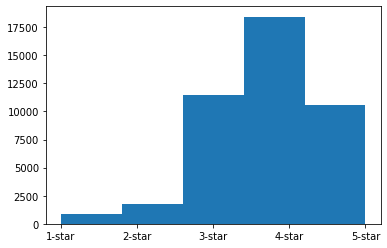

In [8]:
all_review = df.reviews.sum()
all_review_text = ' '.join(all_review)
all_rating = df['ratings'].sum()
# all_rating = [str(i) for i in all_rating]
# count = [all_rating.count(i+1) for i in range(5)]
# print(count)
plt.hist(all_rating, bins = 5)
plt.xticks(np.arange(1, 6), ('1-star', '2-star', '3-star', '4-star', '5-star'))
plt.show()

Here we utilize the sentiment analysis of `Textblob` to acquire the sentiment polarity(negative -1.0 -> positive 1.0) of each review and visualize how it correlates with the star rating and finally found a correlation coefficient of 0.300 between sentiments and star rating. It looks like the low-star reviews indeed convey much more negative emotions.

In [9]:
def get_sentiment(text):
    #getting the polarity of reviews
    
    tb = TextBlob(text)
    return tb.sentiment.polarity

# List of sentiment polarity for all reviews
all_senti = [get_sentiment(t) for t in all_review]

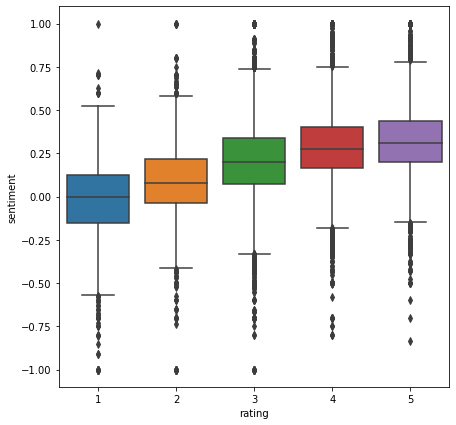

In [10]:
df_senti = pd.DataFrame(list(zip(all_rating, all_senti)), 
               columns =['rating', 'sentiment'])
x = 'rating'
y = 'sentiment'

plt.figure(figsize=(7,7))
sns.boxplot(x = x , y = y, data = df_senti)
plt.show()

In [11]:
pearsonr(all_senti,all_rating)

(0.2997920033706547, 0.0)

### 2-3 Word Cloud

Here we made word loud images to plot reviews of different star ratings and also of schools that have low or high graduation rate, in order to see if they differ and in what way. We made several attempts to find the extra stopwords that don't give us much information about the difference but not in the default stopwords to make our wordcloud more insightful.

In [12]:
stopwords_a = set(STOPWORDS)
stopwords_a.update(['high', 'school', 'people', 'think', 'student', 'class', 'lot', 'much', 'one', \
                  'classes', 'great', 'good','amazing','even', 'come', 'make', 'overall', 'grade',\
                  'small', 'give', 'able', 'make', 'going', 'thing', 'year', 'other', 'feel', 'although', 'definitely'\
                 'made', 'average', 'say', 'go', 'way', 'now', 'well', 'will', 'teacher', 'place', 'always', 'many', \
                  'thing', 'though', 'really', 'anything', 'everything', 'still'])

def create_wc(text):
    wc = WordCloud(stopwords = stopwords_a, max_font_size=180, background_color="white", \
                   width=2000, height=1000).generate(text)

    plt.figure(figsize=(30, 15))
    plt.imshow(wc, interpolation='bilinear')
    plt.axis('off')
    plt.show()

### Comparison between high-star and low-star reviews

Below is the function to get the reviews of a certain star rating and we seperately assign the reviews divided by stars in different columns.

In [13]:
def get_star_review(star, star_list, review_list):
    assert star in [1,2,3,4,5]
    assert len(star_list) == len(review_list)
    out = []
    for i in range(len(star_list)):
        if star_list[i] == star:
            out.append(review_list[i])
    return out

df["1_star_review"] = df.apply(lambda row: get_star_review(1, row['ratings'], row['reviews']), axis = 1)
df["2_star_review"] = df.apply(lambda row: get_star_review(2, row['ratings'], row['reviews']), axis = 1)
df["3_star_review"] = df.apply(lambda row: get_star_review(3, row['ratings'], row['reviews']), axis = 1)
df["4_star_review"] = df.apply(lambda row: get_star_review(4, row['ratings'], row['reviews']), axis = 1)
df["5_star_review"] = df.apply(lambda row: get_star_review(5, row['ratings'], row['reviews']), axis = 1)
one_star_review = ' '.join(df['1_star_review'].sum())
two_star_review = ' '.join(df['2_star_review'].sum())
three_star_review = ' '.join(df['3_star_review'].sum())
four_star_review = ' '.join(df['4_star_review'].sum())
five_star_review = ' '.join(df['5_star_review'].sum())

In [14]:
df

,school_name,ratings,reviews,1_star_review,2_star_review,3_star_review,4_star_review,5_star_review
0,Long Island City High School,"[3, 3, 4, 4, 3, 3, 5, 5, 3, 4, 2, 3, 4, 4, 4, ...",[I dont like this school as much as i thought ...,[do not go to this school if your english is n...,[Long island city has many opportunities but t...,[I dont like this school as much as i thought ...,[This school is what you make of it. In additi...,"[As a incoming senior, Long Island City has we..."
1,Liberty High School Academy for Newcomers,"[4, 5, 5, 5, 3, 3, 5, 4]",[I remember the first time I stepped in Libert...,[],[],[My school is a good school as a foreign schoo...,[I remember the first time I stepped in Libert...,"[I really like how the system works, everyone ..."
2,Eximius College Preparatory Academy,"[3, 5, 3, 4, 3, 3, 4, 4, 5, 1, 5, 5, 3, 1, 3, ...","[Eximius was a school I wont forget, Best four...",[I like how my school allows you to take many ...,[],"[Eximius was a school I wont forget, Best four...",[I love how there is the staff and teachers be...,[With my now 4 years worth of experience at EC...
3,Innovation Diploma Plus,"[5, 5, 5, 4, 3, 3, 1, 3, 1, 1]","[Great school, great experience. Thank you IDP...","[kids do not what to do nothing, I liked the s...",[],[none had kids in the school that didnt want t...,[What I like about innovation ....is the way o...,"[Great school, great experience. Thank you IDP..."
4,Urban Assembly Academy of Government & Law,"[3, 4, 3, 4, 3, 5, 5, 5, 4, 3, 3, 3, 3, 5, 3, ...",[The is an average school. Most of the student...,[],"[The food was just plain cafeteria food, not a...",[The is an average school. Most of the student...,"[My school, Urban Assembly Academy of Governme...",[even though we share a building with 5 other ...
5,High School for Law & Public Service,"[4, 5, 4, 3, 5, 3, 4, 4, 3, 3, 4, 3, 4, 4, 5, ...",[My overall expo at this school is pretty aver...,[There arent many food options. Sometimes the ...,[],"[It's a pretty great school, even for an anti ...",[My overall expo at this school is pretty aver...,[My high school has many clubs and sports that...
6,Middlesex County Vocational School - East Brun...,"[3, 3]",[My experience is decent. I'd like to see an h...,[],[],[My experience is decent. I'd like to see an h...,[],[]
7,Urban Assembly School of Design & Construction,"[4, 4, 4, 1, 5, 3, 3, 5, 5, 4, 4, 3, 4, 3, 4, ...",[I love the staff members. There was this one ...,[I would like to see more motivational teacher...,"[They could do much better, and it makes me sa...",[I selected this school because I wanted to sp...,[I love the staff members. There was this one ...,[The school is a great place for students to t...
8,Plainfield Academy for the Arts & Advanced Stu...,"[3, 2, 4, 4, 4, 5, 3, 4, 4, 4, 4, 4, 5, 3, 4, ...",[I liked how everything was so simple. You kne...,[],[There are little to no clubs and/or after sch...,[I liked how everything was so simple. You kne...,[My experience about PAAAS is that I’ve had ma...,[I’ve been attending PAAAS since the 7th grade...
9,Essex Street Academy,"[3, 3, 4, 4, 4, 4, 3, 4, 4, 5, 5, 3, 4, 4, 4, ...","[Very small school, doesn't prepare students f...",[],[],"[Very small school, doesn't prepare students f...",[There are many ways to get everyone in the sc...,"[I was given a lot of opportunties, The teache..."


Below is the plot of 1 and 2 star reviews.

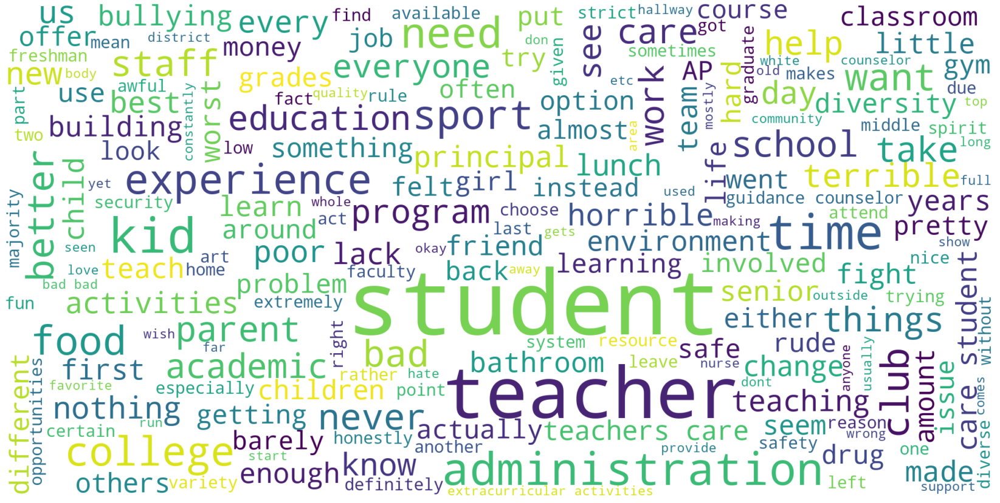

In [15]:
create_wc(' '.join([one_star_review, two_star_review]))

Here is the plot of 3, 4 and 5 star reviews.

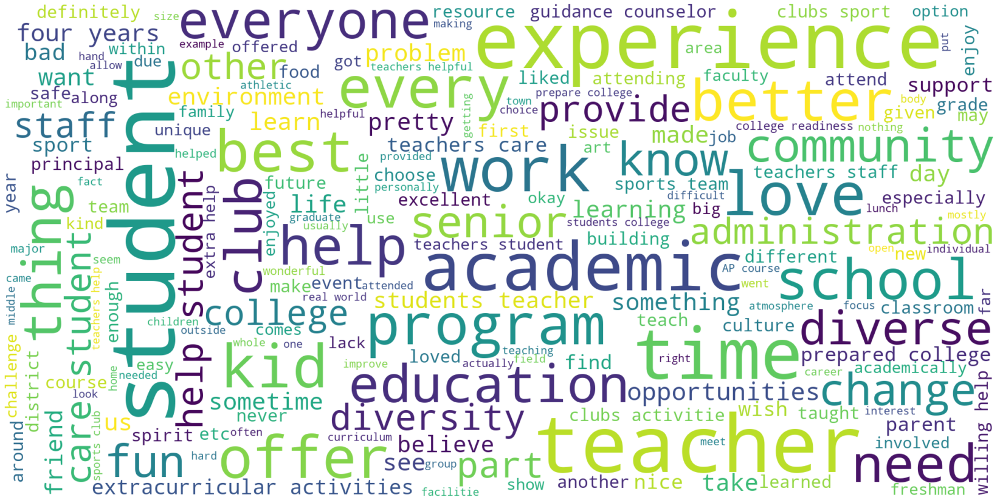

In [16]:
create_wc(' '.join([three_star_review, four_star_review, five_star_review]))

From the two plots above, we can see 3, 4 and 5 star reviews have a stronger emphasis on positive words like diversity, caring students and so on, while in 1 and 2 star reviews, negative words like bullying and rude are mentioned more.

High star reviews:

- Diversity
- Made learn
- Opportunities
- Care student / Help student / Support
- Offered
- Best

Low star reviews:

- Lunch
- Drug
- Bullying
- Rude / Worst
- Nothing
- Bathroom



### Comparison between reviews of high-graduation-rate and low-graduation-rate schools

Now we read in the graduation rate data scraped and classify the reviews based the graduation rate of the schools. A graduation rate above the 75th percentile (>0.92) is considered to be a high one and below the 25th percentile (<0.75) is considered to be a low one.

In [17]:
with open('df_full.csv', newline='', encoding="utf8") as f:
    df_full = pd.read_csv(f)

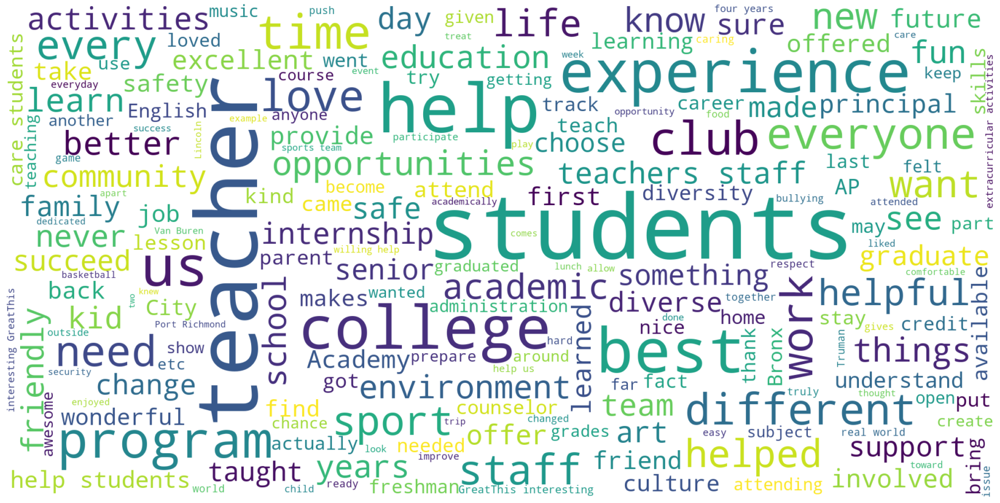

In [18]:
low = df_full.graduation.quantile([0.25,0.75]).iloc[0]
high = df_full.graduation.quantile([0.25,0.75]).iloc[1]

# df_full[df_full.graduation<low].school_name
low_school = df_full[df_full.graduation<low].school_name.tolist()
# df[df['school_name'] == df_full['school_name']]
low_df = df.loc[df['school_name'].isin(low_school)]
low_review = ' '.join(low_df['5_star_review'].sum())
create_wc(low_review)

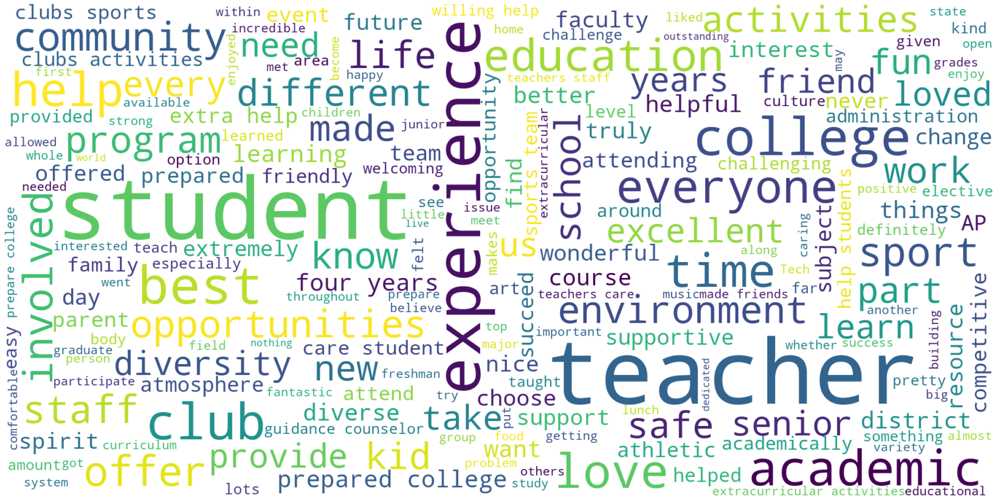

In [19]:
high_school = df_full[df_full.graduation>high].school_name.tolist()
# df[df['school_name'] == df_full['school_name']]
high_df = df.loc[df['school_name'].isin(high_school)]
high_review = ' '.join(high_df['5_star_review'].sum())
create_wc(high_review)

From the two plots above, we can see that words like diversity, support are mentioned more in high graduation rate schools, whereas more realistic and utility words like job and internship are mentioned more.

High graduation rate schools:

- Diversity
- Support
- Spirit
- Prepare college

Low graduation rate schools:

- Job
- Internship
- Graduate
- Taught


## 3 Geographic Distribution

Now let's analyze our feature data to answer the second question: How are public high schools in New York distributed based on different factors?

In [20]:
from geopy.geocoders import Nominatim
import re
import fractions
import requests
import matplotlib.pyplot as plt
%matplotlib inline  
import geopandas as gpd
import seaborn as sns

### 3- 1 Data Clean and Geographic Data Request

In this part, we want to explore the geographical distribution of school features to find out the social factors which may influence the graduation rate of schools. First, we need to clean the clean the address data.

In [21]:
# Read and clean the data

# Read the four address files as dataframes
ad_file1 = pd.read_csv('school_address_174.csv')
ad_file2 = pd.read_csv('school_address_175_400.csv')
ad_file3 = pd.read_csv('school_address_400_764.csv')
ad_file4 = pd.read_csv('school_address_764_1006.csv')

# concatenate the four dataframes
frames = [ad_file1, ad_file2, ad_file3, ad_file4]
df_ad = pd.concat(frames)

# Rename the columns
df_ad.rename(columns={'Unnamed: 0':'school_name',
                          '0':'school_address'}, 
                 inplace=True)
#pd_ad.columns

# Clean the address column
df_ad['school_address'] = df_ad['school_address'].str.replace('Address', '')
df_ad['school_address'] = df_ad['school_address'].str.replace('\n', '')

# add whitespace between words starting with capital letters
def capital_words_spaces(address):
    return re.sub(r"([a-z])([A-Z])", r"\1 \2", address)
df_ad['school_address'] = df_ad['school_address'].apply(capital_words_spaces)

# add whitespace between numbers and capital letters
def digital_space_capital(address):
    return re.sub(r"(\d)([A-Z])", r"\1 \2", address)
df_ad['school_address'] = df_ad['school_address'].apply(digital_space_capital)

address = df_ad.to_csv (r'address.csv', index = None, header=True)

In [22]:
print(len(df_ad))
print(df_ad.head())

1006
                           school_name  \
0               Stuyvesant High School   
1              Bergen County Academies   
2          High Technology High School   
3      Union County Magnet High School   
4  Staten Island Technical High School   

                               school_address  
0          345 Chambers St New York, NY 10282  
1  200 Hackensack Avenue Hackensack, NJ 07601  
2  765 Newman Springs Road Lincroft, NJ 07738  
3   1776 Raritan Road Scotch Plains, NJ 07076  
4      485 Clawson St Staten Island, NY 10306  


Now we get a dataframe including addresses for all 1006 public high schools in New York Area. To plot the schools on the map, we use Geopy to convert the school addresses to coordinates. Geopy can be easily service timed out. So we break all schools into 10 dataframes to run separately.

In [23]:
# Geopy Address, Longtitude, Latitude

# get the correct address from Geopy
# easily service timed out so break into 100 one time
# a little bit slow, need to be patient

nom = Nominatim()

# ignore invalid addresses for Geopy
def eval_results(x):
    try:
        return (x.latitude, x.longitude)
    except:
        return (None, None)

/Users/ruwenyou/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: DeprecationWarning: Using Nominatim with the default "geopy/1.20.0" `user_agent` is strongly discouraged, as it violates Nominatim's ToS https://operations.osmfoundation.org/policies/nominatim/ and may possibly cause 403 and 429 HTTP errors. Please specify a custom `user_agent` with `Nominatim(user_agent="my-application")` or by overriding the default `user_agent`: `geopy.geocoders.options.default_user_agent = "my-application"`. In geopy 2.0 this will become an exception.
  import sys


In [ ]:
df_ad['latitude'] = df_ad['school_address'][0:100].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address1.csv', index = None, header=True)

In [ ]:
df_ad = pd.read_csv('address1.csv')
df_ad['latitude'] = df_ad['school_address'][100:200].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address2.csv', index = None, header=True)

In [ ]:
df_ad = pd.read_csv('address2.csv')
df_ad['latitude'] = df_ad['school_address'][200:300].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address3.csv', index = None, header=True)

In [ ]:
df_ad = pd.read_csv('address3.csv')
df_ad['latitude'] = df_ad['school_address'][300:400].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address4.csv', index = None, header=True)

In [ ]:
df_ad = pd.read_csv('address4.csv')
df_ad['latitude'] = df_ad['school_address'][400:500].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address5.csv', index = None, header=True)

In [ ]:
df_ad = pd.read_csv('address5.csv')
df_ad['latitude'] = df_ad['school_address'][500:600].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address6.csv', index = None, header=True)

In [ ]:
df_ad = pd.read_csv('address6.csv')
df_ad['latitude'] = df_ad['school_address'][600:700].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address7.csv', index = None, header=True)

In [ ]:
df_ad = pd.read_csv('address7.csv')
df_ad['latitude'] = df_ad['school_address'][700:800].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address8.csv', index = None, header=True)

In [ ]:
df_ad = pd.read_csv('address8.csv')
df_ad['latitude'] = df_ad['school_address'][800:900].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address9.csv', index = None, header=True)

In [ ]:
df_ad = pd.read_csv('address9.csv')
df_ad['latitude'] = df_ad['school_address'][900:1000].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address10.csv', index = None, header=True)

In [ ]:
df_ad = pd.read_csv('address10.csv')
df_ad['latitude'] = df_ad['school_address'][1000:1100].apply(nom.geocode).apply(lambda x: eval_results(x))
address = df_ad.to_csv (r'address11.csv', index = None, header=True)

Now we need to concatenate all the addresses into one dataframe.

In [23]:
# read all address csv into dataframe
# If you can't run the Geopy code above (can't request Geopy service)
# please read the csv files we already saved in the folders before.

df_ad1 = pd.read_csv('address1.csv')
df_ad2 = pd.read_csv('address2.csv')
df_ad3 = pd.read_csv('address3.csv')
df_ad4 = pd.read_csv('address4.csv')
df_ad5 = pd.read_csv('address5.csv')
df_ad6 = pd.read_csv('address6.csv')
df_ad7 = pd.read_csv('address7.csv')
df_ad8 = pd.read_csv('address8.csv')
df_ad9 = pd.read_csv('address9.csv')
df_ad10 = pd.read_csv('address10.csv')
df_ad11 = pd.read_csv('address11.csv')

In [24]:
# get the rows which contain the coordinates in each dataframe

df_ad1 = df_ad1[0:100]
df_ad2 = df_ad2[100:200]
df_ad3 = df_ad3[200:300]
df_ad4 = df_ad4[300:400]
df_ad5 = df_ad5[400:500]
df_ad6 = df_ad6[500:600]
df_ad7 = df_ad7[600:700]
df_ad8 = df_ad8[700:800]
df_ad9 = df_ad9[800:900]
df_ad10 = df_ad10[900:1000]
df_ad11 = df_ad11[1000:1050]

In [25]:
# Concatenate the dataframes

frames = [df_ad1, df_ad2, df_ad3, df_ad4, df_ad5, df_ad6, df_ad7, df_ad8, df_ad9, df_ad10, df_ad11]
df_ad = pd.concat(frames)
df_ad.to_csv (r'address_latitude.csv', index = None, header=True)
df_ad.head()

,school_name,school_address,latitude
0,Stuyvesant High School,"345 Chambers St New York, NY 10282","(40.7179876, -74.0138420443421)"
1,Bergen County Academies,"200 Hackensack Avenue Hackensack, NJ 07601","(40.9012393225806, -74.0353447741935)"
2,High Technology High School,"765 Newman Springs Road Lincroft, NJ 07738","(40.3262704, -74.1314886709229)"
3,Union County Magnet High School,"1776 Raritan Road Scotch Plains, NJ 07076","(40.6181661, -74.3568340380298)"
4,Staten Island Technical High School,"485 Clawson St Staten Island, NY 10306","(40.567911, -74.115454)"


We get a row of coordinates ("latitude") for each school now. Then we need to merge the school feature data with the coordinates data. Let's look at the school feature data first.

In [26]:
# read csv file of school features into dataframe

df_sch = pd.read_csv('first.csv')
print(df_sch.dtypes)
print(df_sch.head())

Unnamed: 0                 object
reading                    object
math                       object
graduation                 object
Median Household Income    object
Median Rent                object
Median Home Value          object
Student_Number             object
Free_or_Reduced_Lunch      object
safe                       object
happy                      object
Student_Teacher_Ratio      object
dtype: object
                              Unnamed: 0 reading math graduation  \
0        A. Hamilton Preparatory Academy     69%  26%        96%   
1  A. Philip Randolph Campus High School     95%  94%        75%   
2            Abraham Lincoln High School     89%  91%        67%   
3            Academy Charter High School      8%  12%        85%   
4      Academy for Allied Health Science     99%  92%        95%   

  Median Household Income Median Rent Median Home Value Student_Number  \
0                45,186\n     1,110\n         268,700\n            983   
1                46,4

From the overview above, we need to convert most of the columns to float first and clean some invalid values and unnecessary strings.

In [27]:
# rename the column
df_sch.rename(columns={'Unnamed: 0':'school_name',
                       'Median Household Income':'Median_Household_Income',
                       'Median Rent':'Median_Rent',
                       'Median Home Value':'Median_Home_Value'}, 
              inplace=True)

# clean unnecessary string
df_sch['Median_Household_Income'] = df_sch['Median_Household_Income'].str.replace('\n', '')
df_sch['Median_Rent'] = df_sch['Median_Rent'].str.replace('\n', '')
df_sch['Median_Home_Value'] = df_sch['Median_Home_Value'].str.replace('\n', '')
df_sch['Median_Household_Income'] = df_sch['Median_Household_Income'].str.replace(',', '')
df_sch['Median_Rent'] = df_sch['Median_Rent'].str.replace(',', '')
df_sch['Median_Home_Value'] = df_sch['Median_Home_Value'].str.replace(',', '')
df_sch['Student_Number'] = df_sch['Student_Number'].str.replace(',', '')
df_sch['Student_Teacher_Ratio'] = df_sch['Student_Teacher_Ratio'].str.replace(':00', '')
df_sch['Student_Teacher_Ratio'] = df_sch['Student_Teacher_Ratio'].str.replace(':', '/')

# replace invalid value to NaN
df_sch.replace('_', np.nan, inplace = True)
df_sch.replace('--', np.nan, inplace = True)
df_sch.replace('970\n55 responses', np.nan, inplace = True)

# convert the types of the column to string/float
df_sch["school_name"] = df_sch['school_name'].astype(str)
df_sch['reading'] = df_sch['reading'].str.rstrip('%').astype('float') / 100.0
df_sch['math'] = df_sch['math'].str.rstrip('%').astype('float') / 100.0
df_sch['graduation'] = df_sch['graduation'].str.rstrip('%').astype('float') / 100.0
df_sch['Median_Household_Income'] = df_sch['Median_Household_Income'].astype('float')
df_sch['Median_Rent'] = df_sch['Median_Rent'].astype('float')
df_sch['Median_Home_Value'] = df_sch['Median_Home_Value'].astype('float')
df_sch['Student_Number'] = df_sch['Student_Number'].astype('float')
df_sch['Free_or_Reduced_Lunch'] = df_sch['Free_or_Reduced_Lunch'].str.rstrip('%').astype('float') / 100.0
df_sch['safe'] = df_sch['safe'].str.rstrip('%').astype('float') / 100.0
df_sch['happy'] = df_sch['happy'].str.rstrip('%').astype('float') / 100.0
df_sch['Student_Teacher_Ratio'] = df_sch['Student_Teacher_Ratio'].apply(lambda frac: float(sum([fractions.Fraction(x) for x in frac.split()])))
print(df_sch.dtypes)
print(df_sch.head())

school_name                 object
reading                    float64
math                       float64
graduation                 float64
Median_Household_Income    float64
Median_Rent                float64
Median_Home_Value          float64
Student_Number             float64
Free_or_Reduced_Lunch      float64
safe                       float64
happy                      float64
Student_Teacher_Ratio      float64
dtype: object
                             school_name  reading  math  graduation  \
0        A. Hamilton Preparatory Academy     0.69  0.26        0.96   
1  A. Philip Randolph Campus High School     0.95  0.94        0.75   
2            Abraham Lincoln High School     0.89  0.91        0.67   
3            Academy Charter High School     0.08  0.12        0.85   
4      Academy for Allied Health Science     0.99  0.92        0.95   

   Median_Household_Income  Median_Rent  Median_Home_Value  Student_Number  \
0                  45186.0       1110.0           268700.0   

Let's merge the coordinate address dataframe with the school feature dataframe and separate coordinates into latitude and longitude.

In [28]:
# merge the two dataframes
df_full = df_ad.merge(df_sch, how="inner", left_on = "school_name", right_on="school_name")

# rename the 'latitude' to 'coordinate'
df_full.rename(columns={'latitude':'coordinate'}, inplace=True)

# separate coordinates into latitude and longitude
df_full['coordinate'] = df_full['coordinate'].str.replace('(', '')
df_full['coordinate'] = df_full['coordinate'].str.replace(')', '')

from ast import literal_eval

df_full['coordinate'] = [literal_eval(x) for x in df_full['coordinate']]
df_full[['lat','lon']] = pd.DataFrame(df_full['coordinate'].values.tolist(), index=df_full.index)

df_full.to_csv (r'df_full.csv', index = None, header=True)

In [29]:
# check the df_full dataframe
df_full.head()

,school_name,school_address,coordinate,reading,math,graduation,Median_Household_Income,Median_Rent,Median_Home_Value,Student_Number,Free_or_Reduced_Lunch,safe,happy,Student_Teacher_Ratio,lat,lon
0,Stuyvesant High School,"345 Chambers St New York, NY 10282","(40.7179876, -74.0138420443421)",0.99,0.99,0.98,190216.0,3084.0,1143983.0,3368.0,0.45,0.93,0.80,21.0,40.717988,-74.013842
1,Bergen County Academies,"200 Hackensack Avenue Hackensack, NJ 07601","(40.9012393225806, -74.0353447741935)",NaN,NaN,NaN,NaN,NaN,NaN,1069.0,0.05,0.90,0.75,11.0,40.901239,-74.035345
2,High Technology High School,"765 Newman Springs Road Lincroft, NJ 07738","(40.3262704, -74.1314886709229)",0.99,0.95,0.95,132135.0,392.0,495800.0,291.0,0.02,0.82,0.64,13.0,40.326270,-74.131489
3,Union County Magnet High School,"1776 Raritan Road Scotch Plains, NJ 07076","(40.6181661, -74.3568340380298)",0.99,0.95,0.95,117765.0,1481.0,481500.0,298.0,0.10,0.83,0.67,13.0,40.618166,-74.356834
4,Staten Island Technical High School,"485 Clawson St Staten Island, NY 10306","(40.567911, -74.115454)",0.99,0.99,0.99,93479.0,1441.0,539760.0,1313.0,0.39,0.97,0.89,23.0,40.567911,-74.115454


In [30]:
# drop the rows which don't have invalid latitudes and longtitudes
df_full = df_full[np.isfinite(df_full['lat'])]

We have finished all the prior work. Let's use Folium to make the interactive data map for school features.

### 3- 2 Distribution Map

In [31]:
import folium
from folium import plugins

Let's first look at the geographical distribution of schools. We use heatmap to show it. The red color means schools gather in this area. From the maps below, we can see most of the schools gather in Bronx, Brooklyn and Mahattan.

In [32]:
# create the heatmap of school distribution
schools_heatmap = folium.Map(location=[df_full['lat'].mean(), df_full['lon'].mean()], zoom_start=10)
schools_heatmap.add_children(plugins.HeatMap([[row["lat"], row["lon"]] for name, row in df_full.iterrows()]))
schools_heatmap.save("heatmap.html")
schools_heatmap

/Users/ruwenyou/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: FutureWarning: Method `add_children` is deprecated. Please use `add_child` instead.
  This is separate from the ipykernel package so we can avoid doing imports until


In [ ]:
# If the html doesn't show, please see the folloing picture.

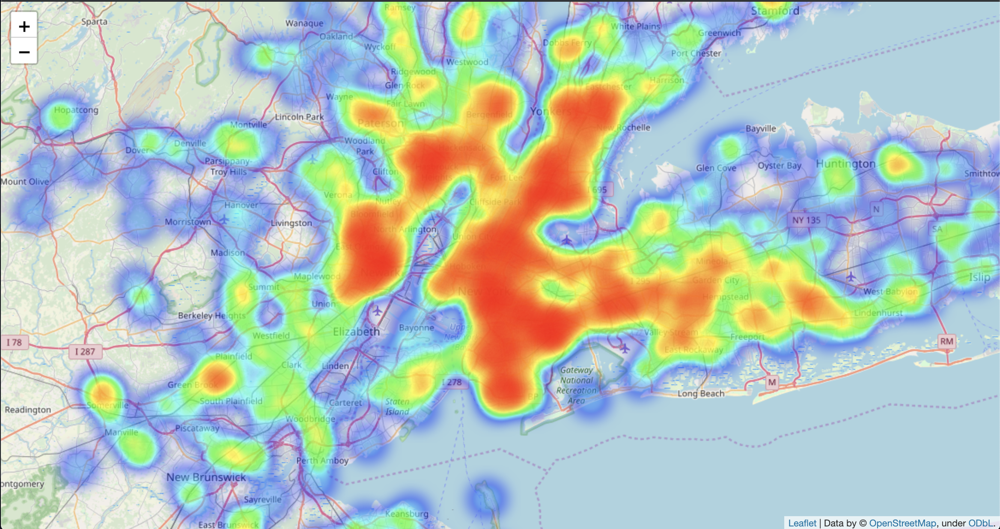

Now let's explore the geographic distribution of graduation rate for the high schools. We use four colors to show four quartile ranges of the graduation rate. The lighter the color is, the higher the graduation is.

In [33]:
# drop the rows with invalid graduation data.
df_graduation = df_full[np.isfinite(df_full['graduation'])]

# create the column of four quartile ranges of the graduation rate
df_graduation['graduation_q'] = pd.qcut(df_graduation['graduation'], 4, labels=False)

/Users/ruwenyou/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """


In [34]:
# check the column
df_graduation['graduation_q'].head()

0    3
2    2
3    2
4    3
5    3
Name: graduation_q, dtype: int64

In [35]:
# set the color of each range of graduation rate
# lightblue: 75-100%; lightgreen: 50-75%; orange: 25-50%; red: 0-25%.
colordict = {3: 'lightblue', 2: 'lightgreen', 1: 'orange', 0: 'red'}

# create the center of the map based on the mean of coordinates
graduation_map = folium.Map(location=[df_graduation['lat'].mean(), df_graduation['lon'].mean()], zoom_start=10)

# create the graduation distribution map
for lat, lon, school_name, graduation, graduation_q in zip(df_graduation['lat'], df_graduation['lon'], df_graduation['school_name'], df_graduation['graduation'], df_graduation['graduation_q']):
    folium.CircleMarker(
        [lat, lon],
        radius=graduation*10,
        popup = ('School: ' + str(school_name) + '<br>'
                 'Graduation: ' + str(graduation) + '<br>'
                ),
        color='b',
        key_on = graduation_q,
        threshold_scale=[0,1,2,3],
        fill_color=colordict[graduation_q],
        fill=True,
        fill_opacity=0.7
        ).add_to(graduation_map)
graduation_map.save("graduation_heatmap.html")
graduation_map

In [53]:
# If the html doesn't show, please see the following picture

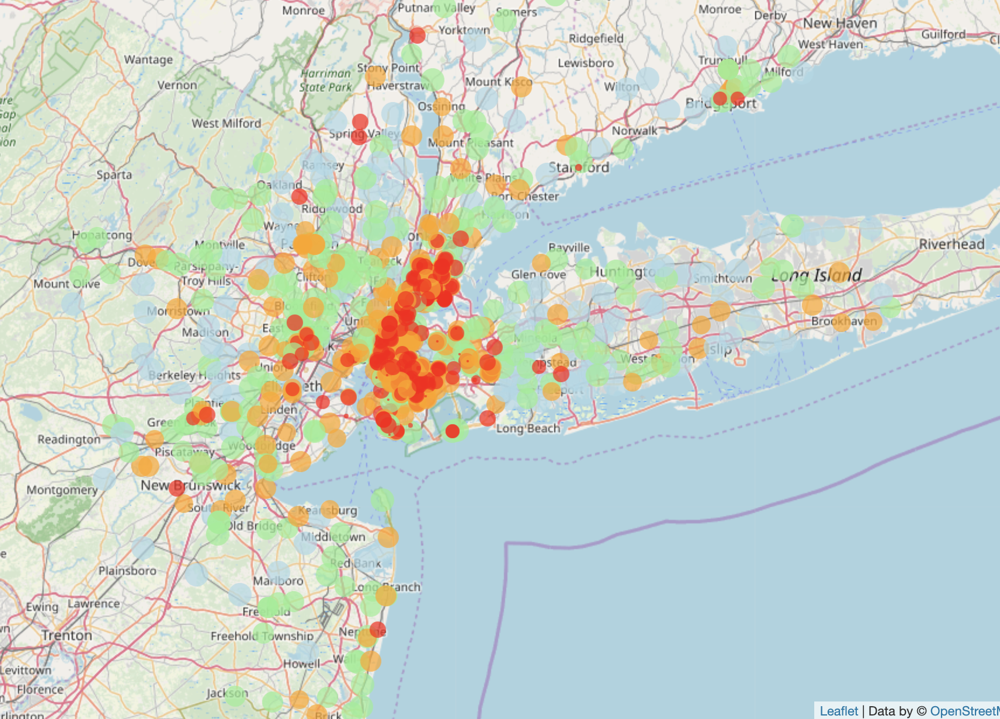

As you can see from the above map, most of the lower graduation school gathers in the Bronx, Mahattan and Brooklyn. We hypothesize that some factors related to the districts may influence the graduation rate. We pick "Median_Household_Income" as a factor and make a geographic map for it. We want to see if the income level is related to the graduation rate.

We still divide the income level based on the quantile ranges of "Median_Household_Income" and use the same way to plot the household income level of each school. The lighter the color is, the higher the income level is.

In [36]:
# drop the rows with invalid 'Median_Household_Income'
df_income = df_full[np.isfinite(df_full['Median_Household_Income'])]

In [37]:
# set the color of each range of graduation rate
# lightblue: 75-100%; lightgreen: 50-75%; orange: 25-50%; red: 0-25%.
df_income['income_q'] = pd.qcut(df_income['Median_Household_Income'], 4, labels=False)
colordict = {3: 'lightblue', 2: 'lightgreen', 1: 'orange', 0: 'red'}

# create the center of the map based on the mean of coordinates
income_map = folium.Map(location=[df_full['lat'].mean(), df_full['lon'].mean()], zoom_start=9)

# create the graduation distribution map
for lat, lon, school_name, income, income_q in zip(df_income['lat'], df_income['lon'], df_income['school_name'], df_income['Median_Household_Income'], df_income['income_q']):
    folium.CircleMarker(
        [lat, lon],
        radius=income*0.00015,
        popup = ('School: ' + str(school_name) + '<br>'
                 'Median Income: ' + str(income) + '<br>'
                ),
        color='b',
        key_on = income_q,
        threshold_scale=[0,1,2,3],
        fill_color=colordict[income_q],
        fill=True,
        fill_opacity=0.7
        ).add_to(income_map)
income_map.save("income_heatmap.html")
income_map

/Users/ruwenyou/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [54]:
# If the html can't show, please see the following picture

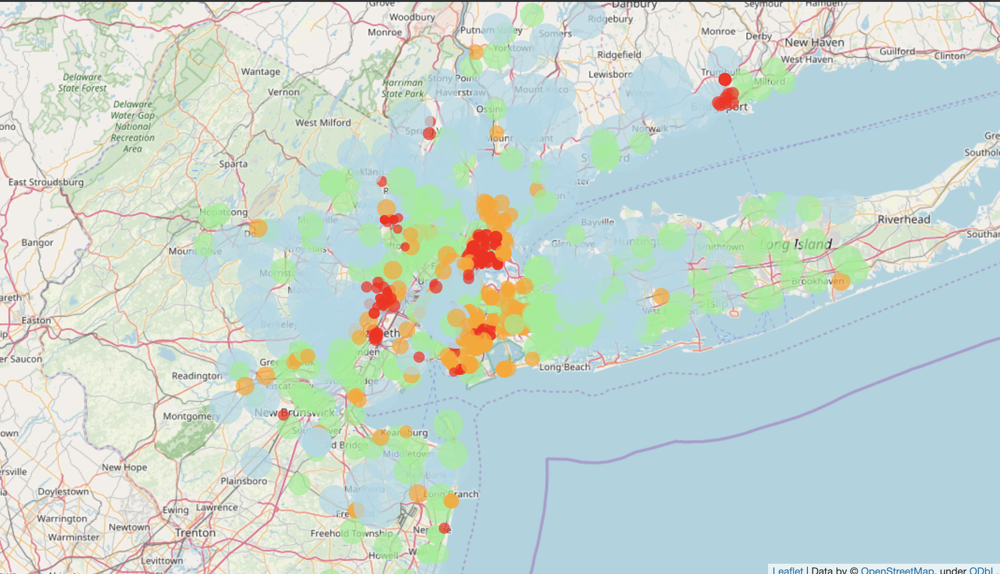

Comparing the income map above with the prior graduation map, you can see that there are similar patterns between them. For example, the Bronx and Brooklyn both have lower graduation rate and lower income level. But we can also see exceptions. For example, Manhatton has higher level income level but lower graduation rate.

## 4 Factor influence

Now, let's explore more to ask the third question: What factors might influence the average graduation rate of public high schools in NY?

### 4- 1 T-test

We use T-test to find out the difference between the patterns in the map. We find the clusters in the pictures below and use the coordinates of boundary schools in the clusters to locate them.

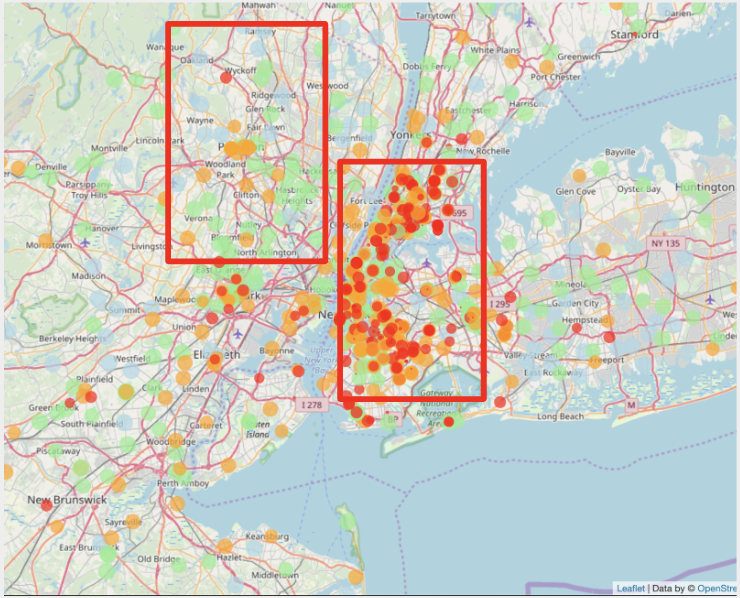

In [38]:
# find the coordinates of the boundary schools
# create the dataframe for the two clusters

lon_l_index = df_graduation.loc[df_graduation['school_name']=='Marta Valle High School'].index[0]
lon_l = df_graduation['lon'][lon_l_index]
lon_r_index = df_graduation.loc[df_graduation['school_name']=='Pan American International High School'].index[0]
lon_r = df_graduation['lon'][lon_r_index]
lat_d_index = df_graduation.loc[df_graduation['school_name']=='Academy of Medical Technology - A College Board School'].index[0]
lat_d = df_graduation['lat'][lat_d_index]
lat_u_index = df_graduation.loc[df_graduation['school_name']=='International Leadership Charter School'].index[0]
lat_u = df_graduation['lat'][lat_u_index]

df_l_gra = df_graduation[df_graduation['lon'] > lon_l]
df_r_gra = df_l_gra[df_l_gra['lon'] < lon_r]
df_d_gra = df_r_gra[df_r_gra['lat'] > lat_d]
df_gra_low = df_d_gra[df_d_gra['lat'] < lat_u]

lon2_index = df_graduation.loc[df_graduation['school_name']=='Queens High School of Teaching'].index[0]
lon2 = df_graduation['lon'][lon2_index]
lon3_index = df_graduation.loc[df_graduation['school_name']=='Sewanhaka High School'].index[0]
lon3 = df_graduation['lon'][lon3_index]
lat2_index = df_graduation.loc[df_graduation['school_name']=='Oceanside High School'].index[0]
lat2 = df_graduation['lat'][lat2_index]
lat3_index = df_graduation.loc[df_graduation['school_name']=='Earl L. Vandermeulen High School'].index[0]
lat3 = df_graduation['lat'][lat3_index]

df1_gra = df_graduation[df_graduation['lon'] > lon2]
df2 = df1_gra[df1_gra['lon'] < lon3]
df3 = df2[df2['lat'] > lat2]
df_gra_high = df3[df3['lat'] < lat3]

In [39]:
# T-test on all the features of the schools

from scipy.stats import ttest_ind
Reading = ttest_ind(df_gra_low['reading'], df_gra_high['reading'])

df_gra_low = df_gra_low[np.isfinite(df_gra_low['math'])]
df_gra_high = df_gra_high[np.isfinite(df_gra_high['math'])]

Math = ttest_ind(df_gra_low['math'], df_gra_high['math'])
Median_Household_Income = ttest_ind(df_gra_low['Median_Household_Income'], df_gra_high['Median_Household_Income'])
Median_Rent = ttest_ind(df_gra_low['Median_Rent'], df_gra_high['Median_Rent'])
Median_Home_Value = ttest_ind(df_gra_low['Median_Home_Value'], df_gra_high['Median_Home_Value'])
Student_Number = ttest_ind(df_gra_low['Student_Number'], df_gra_high['Student_Number'])
Free_or_Reduced_Lunch = ttest_ind(df_gra_low['Free_or_Reduced_Lunch'], df_gra_high['Free_or_Reduced_Lunch'])
df_gra_low = df_gra_low[np.isfinite(df_gra_low['safe'])]
df_gra_high = df_gra_high[np.isfinite(df_gra_high['safe'])]
Safe = ttest_ind(df_gra_low['safe'], df_gra_high['safe'])
df_gra_low = df_gra_low[np.isfinite(df_gra_low['happy'])]
df_gra_high = df_gra_high[np.isfinite(df_gra_high['happy'])]
Happy = ttest_ind(df_gra_low['happy'], df_gra_high['happy'])
Student_Teacher_Ratio = ttest_ind(df_gra_low['Student_Teacher_Ratio'], df_gra_high['Student_Teacher_Ratio'])

In [40]:
# convert the T-test results to a dataframe

df_ttest = pd.DataFrame()
df_ttest['Reading'] = Reading
df_ttest['Math'] = Math
df_ttest['Median_Household_Income'] = Median_Household_Income
df_ttest['Median_Rent'] = Median_Rent
df_ttest['Median_Home_Value'] = Median_Home_Value
df_ttest['Student_Number'] = Student_Number
df_ttest['Free_or_Reduced_Lunch'] = Free_or_Reduced_Lunch
df_ttest['Safe'] = Safe
df_ttest['Happy'] = Happy
df_ttest['Student_Teacher_Ratio'] = Student_Teacher_Ratio
df_ttest_transposed = df_ttest.T.round(3)
df_ttest_transposed.rename(columns={0: "T-Value", 1: "p-value"})

,T-Value,p-value
Reading,-1.654,0.099
Math,-1.969,0.050
Median_Household_Income,-4.594,0.000
Median_Rent,-1.705,0.089
Median_Home_Value,-1.401,0.162
Student_Number,-2.263,0.024
Free_or_Reduced_Lunch,8.770,0.000
Safe,0.177,0.860
Happy,0.505,0.614
Student_Teacher_Ratio,1.820,0.071


From the T-test results above, we can see that Math, Median_Household_Income, Student_Number and Free_or_Reduced_Lunch have significant difference between the two clusters. All these features are higher in schools with higher graduation rates except Free_or_Reduced_Lunch. The biggest difference also happens on Free_or_Reduced_Lunch. We can make assumption that study (Math), social economic status (Median_Household_Income), Student_Number all have positve influence on the graduation rate. But Low graduation rate school may have more needs on free_or_Reduced_Lunch.

### 4- 2 Correlation

Let's go back to the full sample and use correlation analysis to test our assumptions.

In [41]:
# read the full sample data
df_full = pd.read_csv('df_full.csv')

# remove the coordinates data
df_corr = df_full[['reading', 'math', 'graduation', 'Median_Household_Income', 
                   'Median_Rent', 'Median_Home_Value', 'Student_Number', 'Free_or_Reduced_Lunch',
                   'safe', 'happy', 'Student_Teacher_Ratio']]

In [42]:
# correlation Analysis

cm = df_corr.corr()
cm

,reading,math,graduation,Median_Household_Income,Median_Rent,Median_Home_Value,Student_Number,Free_or_Reduced_Lunch,safe,happy,Student_Teacher_Ratio
reading,1.000000,0.933167,0.055198,0.181728,0.256807,0.296964,0.053216,-0.051341,0.251841,0.229925,0.366205
math,0.933167,1.000000,0.013754,0.116594,0.214791,0.262026,0.042157,0.028645,0.224151,0.214398,0.371856
graduation,0.055198,0.013754,1.000000,0.400917,0.234131,0.118879,0.313467,-0.526028,0.374493,0.188272,-0.031906
Median_Household_Income,0.181728,0.116594,0.400917,1.000000,0.749960,0.731328,0.209494,-0.679098,0.318926,0.113441,-0.119405
Median_Rent,0.256807,0.214791,0.234131,0.749960,1.000000,0.721526,0.109859,-0.353262,0.197032,0.038397,0.004937
Median_Home_Value,0.296964,0.262026,0.118879,0.731328,0.721526,1.000000,0.072537,-0.258025,0.200933,0.052857,0.051414
Student_Number,0.053216,0.042157,0.313467,0.209494,0.109859,0.072537,1.000000,-0.265592,-0.018810,0.114802,0.175205
Free_or_Reduced_Lunch,-0.051341,0.028645,-0.526028,-0.679098,-0.353262,-0.258025,-0.265592,1.000000,-0.373909,-0.165836,0.193799
safe,0.251841,0.224151,0.374493,0.318926,0.197032,0.200933,-0.018810,-0.373909,1.000000,0.618294,0.002469
happy,0.229925,0.214398,0.188272,0.113441,0.038397,0.052857,0.114802,-0.165836,0.618294,1.000000,0.091594


Text(68.09374999999999, 0.5, 'correlation')

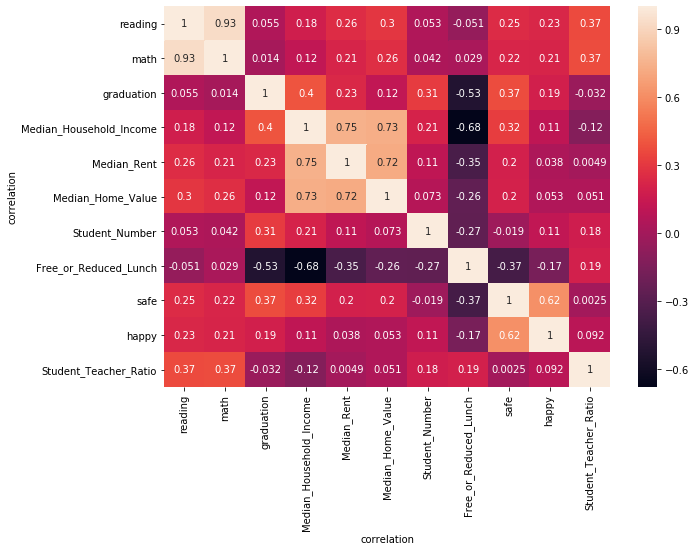

In [43]:
# visualize the correlation matrix

plt.figure(figsize = (10, 7))
sns.heatmap(cm, annot = True)
plt.xlabel('correlation')
plt.ylabel('correlation')

From the correlation matrix above, we can see that Free_or_Reduced_Lunch has bigger negative correlation with both graduation and Median_Household_Income. Schools with high free or reduced lunch needs also need more economic support. From the correlation coeffients between graduation and social economic status factors (Median_Household_Income, Median_Rent, Median_Home_Value), we can see that high social economic status will have positive influence on the graduation rate.

It's also suprised that math and reading scores don't have strong correlation with graduation compared to other features. From this we can speculate that if we define the school in terms of graduation rate and academic performance, we may get completely different results. Good grades may not lead to high graduation rates.

## 5 Predictive Model

In the final part, we want to use the features we have to build a predictive model for graduation rate. We use the average graduation rate to classify the graduation rate into two categories: high graduation rate (>average) and low graduation rate (<average). We choose Decision Tree, Random Forest and KNeighbors to build the model, and compare the accuracy.

In [44]:
from sklearn import preprocessing
from sklearn.tree import DecisionTreeClassifier as DTree
from sklearn.ensemble import RandomForestClassifier as RF
from sklearn.neighbors import KNeighborsClassifier as KNN
from sklearn.model_selection import train_test_split
from matplotlib import pyplot as plt
from sklearn import metrics
from sklearn.metrics import classification_report as cls_rep
from sklearn.metrics import accuracy_score as ac

In [45]:
# read the full data set

df_full = pd.read_csv('df_full.csv')

In [46]:
# use the mean of each column to replace the invalid values

df_full['reading'].fillna((df_full['reading'].mean()), inplace=True)
df_full['math'].fillna((df_full['math'].mean()), inplace=True)
df_full['graduation'].fillna((df_full['graduation'].mean()), inplace=True)
df_full['Median_Household_Income'].fillna((df_full['Median_Household_Income'].mean()), inplace=True)
df_full['Median_Rent'].fillna((df_full['Median_Rent'].mean()), inplace=True)
df_full['Median_Home_Value'].fillna((df_full['Median_Home_Value'].mean()), inplace=True)
df_full['Student_Number'].fillna((df_full['Student_Number'].mean()), inplace=True)
df_full['Free_or_Reduced_Lunch'].fillna((df_full['Free_or_Reduced_Lunch'].mean()), inplace=True)
df_full['safe'].fillna((df_full['safe'].mean()), inplace=True)
df_full['happy'].fillna((df_full['happy'].mean()), inplace=True)
df_full['Student_Teacher_Ratio'].fillna((df_full['Student_Teacher_Ratio'].mean()), inplace=True)

In [47]:
# recode the graduation rate with 1 (higher than average), 0 (lower than average)

gra_ave = df_full['graduation'].mean()
print(gra_ave)
df_full["gra_high"] = df_full['graduation'].apply(lambda x: 1 if x > gra_ave else 0)
df = df_full[['reading', 'math', 'gra_high', 'Median_Household_Income', 'Median_Rent', 
              'Median_Home_Value', 'Student_Number', 'Free_or_Reduced_Lunch', 'safe', 
              'happy', 'Student_Teacher_Ratio']]
df.head()

0.8129700854700852


,reading,math,gra_high,Median_Household_Income,Median_Rent,Median_Home_Value,Student_Number,Free_or_Reduced_Lunch,safe,happy,Student_Teacher_Ratio
0,0.990000,0.990000,1,190216.000000,3084.000000,1.143983e+06,3368.0,0.45,0.93,0.80,21.0
1,0.736527,0.646735,1,76707.738659,1443.290927,4.366174e+05,1069.0,0.05,0.90,0.75,11.0
2,0.990000,0.950000,1,132135.000000,392.000000,4.958000e+05,291.0,0.02,0.82,0.64,13.0
3,0.990000,0.950000,1,117765.000000,1481.000000,4.815000e+05,298.0,0.10,0.83,0.67,13.0
4,0.990000,0.990000,1,93479.000000,1441.000000,5.397600e+05,1313.0,0.39,0.97,0.89,23.0


In [48]:
# functions for model fit

def run_clf(X_train,X_test,y_train,class_type,**kwargs):
    clf = class_type(**kwargs)
    clf.fit(X_train,y_train)  
    y_pred = clf.predict(X_test)
    return y_pred
def run_RF(X_train,X_test,y_train,RF):
    clf = RF(n_estimators=100)
    clf.fit(X_train,y_train)  
    y_pred = clf.predict(X_test)
    return y_pred

In [49]:
# split train and test data

y = df.gra_high
X = df[['reading','math','Median_Household_Income','Median_Rent','Median_Home_Value','Student_Number',
        'Free_or_Reduced_Lunch','safe','happy','Student_Teacher_Ratio']]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state = 1)
print(X_train.shape, y_train.shape)
print(X_test.shape, y_test.shape)

(812, 10) (812,)
(204, 10) (204,)


In [50]:
# result of the model

target_names=["High Graduation","Low Graduation"]
i=0
method=['DecisionTree','K-NN']
cls=[DTree,KNN]
while i<=1:
    print(method[i])
    print(cls_rep(y_test, run_clf(X_train,X_test,y_train,cls[i]),target_names=target_names))
    print('Accuracy:',ac(y_test, run_clf(X_train,X_test,y_train,cls[i])))
    i+=1     
print('Randomforest')
print(cls_rep(y_test, run_RF(X_train,X_test,y_train,RF),target_names=target_names))
print('Accuracy:',ac(y_test, run_RF(X_train,X_test,y_train,RF)))

DecisionTree
                 precision    recall  f1-score   support

High Graduation       0.61      0.69      0.65        67
 Low Graduation       0.84      0.79      0.81       137

       accuracy                           0.75       204
      macro avg       0.73      0.74      0.73       204
   weighted avg       0.76      0.75      0.76       204

Accuracy: 0.7696078431372549
K-NN
                 precision    recall  f1-score   support

High Graduation       0.56      0.49      0.52        67
 Low Graduation       0.77      0.81      0.79       137

       accuracy                           0.71       204
      macro avg       0.66      0.65      0.66       204
   weighted avg       0.70      0.71      0.70       204

Accuracy: 0.7058823529411765
Randomforest
                 precision    recall  f1-score   support

High Graduation       0.79      0.78      0.78        67
 Low Graduation       0.89      0.90      0.89       137

       accuracy                           0.86  

We evaluate the performance of the classifiers by using AUC and ROC. Below are the way we build our AUC - ROC Curves.

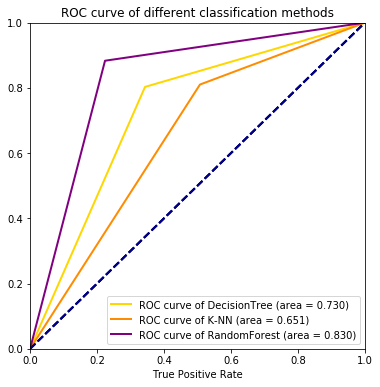

In [51]:
from sklearn.metrics import roc_curve,auc
# Compute ROC curve and ROC area for each class
def acu_curve(y_test,y_pred,cls_me,color):
    fpr, tpr, thresholds  =  roc_curve(y_test, y_pred) #fpr and tpr
    roc_auc =auc(fpr, tpr) # auc
    lw = 2
    plt.plot(fpr, tpr, color=color,
             lw=lw, label='ROC curve of {} '.format(cls_me)+'(area = %0.3f)' % roc_auc) ###x-axis: fpr，y-axis:tpr
    plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.0])
    ax.set_xlabel('False Positive Rate')
    ax.set_xlabel('True Positive Rate')
    ax.set_title('ROC curve of different classification methods')
    ax.legend(loc="lower right")
fig, ax = plt.subplots(figsize = (6, 6))
acu_curve(y_test, run_clf(X_train,X_test,y_train,DTree),'DecisionTree','gold')
acu_curve(y_test, run_clf(X_train,X_test,y_train,KNN),'K-NN','darkorange')
acu_curve(y_test, run_RF(X_train,X_test,y_train,RF),'RandomForest','purple')
plt.show()

As we can see from the curves, Random Forest has the best performance. Let's use it to predict the graduation rate for test dataset.

In [52]:
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier(n_estimators = 100)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)
y_pred

array([1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 0, 1, 1, 1, 1, 1,
       1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 0, 1,
       1, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 1, 1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0,
       1, 1, 1, 1, 1, 1, 1, 1, 0, 1, 1, 0, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1,
       1, 0, 1, 1, 1, 0, 1, 1, 1, 1, 0, 1, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0,
       0, 1, 1, 1, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0,
       1, 0, 0, 0, 0, 0, 1, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 1, 1,
       0, 1, 1, 0, 1, 0])

## Appendix

In [21]:
%pip install selenium
import os
import sys
import time
import zipfile
import re
import csv
from urllib.request import urlretrieve
from selenium import webdriver
from getpass import getpass
from selenium.common.exceptions import NoSuchElementException
from selenium.common.exceptions import StaleElementReferenceException
from selenium.common.exceptions import ElementClickInterceptedException
import pandas as pd 
from bs4 import BeautifulSoup
import re

Note: you may need to restart the kernel to use updated packages.


### Step 1: Get the school list and save it for next steps

### Step 2: Get the datailed school information

### Step 3: Get the 60 latest reviews from each school

### Step 4: Get the school address